# Beach Volleyball Stats and Weather Data

Project done by Francisco Valle

**1. What is your project topic?  Briefly summarize what you’re trying to accomplish**


My project topic is determining if weather conditions affect Beach Volleyball's main game stats (kills, errors, aces, etc) in a meaninful way and quantify it. I began by gathering information and assumptions from my own experience in playing beach volleyball, from online researh and Professor Abramson's volleybal player contacts. After this, I decided to test the following hypothesis: <br>
1- Higher wind speed increase the probability of Aces per point played. This is based on information that Serves performed when there are higher wind speed the balls lands sooner. <br>
2- Location affects the probability of Kills per point played. (For instance, sand depth might affect the number of kills by making it harder to jump). <br>
3- Rain increases the probability of Serve Errors per point played. <br>
4.1- Higher temperatures affect the probability of Errors per point played. <br>
4.2- Minutes played at higher temperature affect the probability of Errors per point played. As this may cause increased fatigue in players. <br>
5- Humidity increases the probability of Kills per point played. Moisture/rain packs sand which can make it easier to jump, thus, creating more kills. <br>
6- Lower atmospheric pressure increases the probability of Errors per point played. Lower pressure may make the ball fall further and cause more out of bounds. <br>

<strong>2. What were the “results” of your work?  (What does your software package “do”, or what were the relevant evaluation metrics for your model, or what were the relationships between variables you were exploring, etc.)<strong>

The metrics and relationship I was analyzing are the hypothesis I explained on the previous question (and some others discarded). In general terms, the weather data I analyzed does not have a major impact on the game. However, I found some relations that have statistical significance. Also, there is a lot of opportunity to analyze further by using more detailed data. The summary result of my analysis by hypothesis is shown in the following table. 
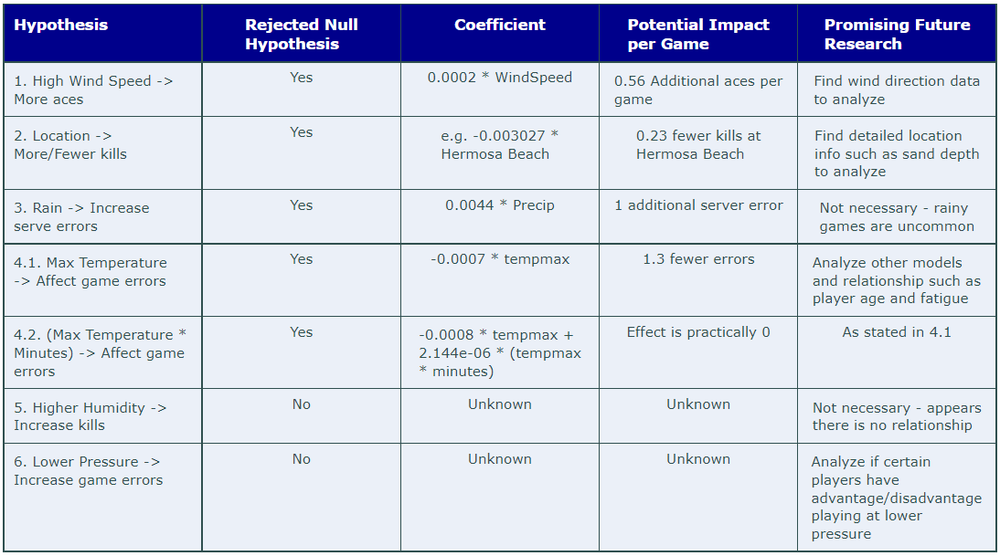

<strong>3. What would the next logical step be in this exploration?<strong>


First, I would need to find other data sources to increase the data available for the study. Ideally, with more specific information
about the location, such as sand type, wind direction. If by using the additional data, more signicant results are obtained, I could create a macro model that takes into account the different effects of weather on a game. For example, if certain weather situations increase the frequency of errors, aces or kills.


**4.	What did you find difficult to do during the project?**



One of the most challenging apects of the project was the creation of the data set. Most of these steps are not in the notebook but were a core part of my project and finding a good and cheap weather API was difficult. Additionally, I needed more knowledge regarding correct research methodology, which made me question some of the validity of my results. 

**5.	What topic did you wish you were more knowledgeable about/what would have been handy to know while you were doing the project?**

In line with my previous response, I think having more experience in actual research would be very helpful with better steps to validate the data and my results. Additionally, would liked to have had a  better understanding of causality and DAGS. I did a few DAGS during this project but I'm not sure these are all well done. 
On a more techinical aspect, I'd like to have more skills in visualization. It took me quite some time to generate the plots. I learned many different visualization tools with this project. It is certainly an area that seems simple but there is a lot to explore. I had not used plotly before and it provided some great interactive plots capabilities.

# Sections

The Analysis has the following sections: <br>
a. Data Source <br>
b. Data Manipulation <br>
c. Exploratory Data Analysis <br>
d. Hypothesis Testing <br>
e. Summary Results: Table of Hypothesis Testing and Potential next steps

# a. Data Sources


I generate the Dataset using the following: <br /> 
- Github repository with games data: https://github.com/BigTimeStats/beach-volleyball 
- Google's map geocoding to get the GPS 
- Visualcrossing API to get Historic data using date and GPS coordinates: https://www.visualcrossing.com/weather-api

# b. Data Manipulation

Data wrangling to generate metrics to be use on the hypothesis tests

In [1]:
#I did further data modifications in this notebook and not in the saved data set
#to alow other beach volleyball enthusiasts to use the cleaner dataset I saved.
import pandas as pd 
df = pd.read_csv('dataset.csv')

In [2]:
df

,circuit,tournament,country,year,date,gender,match_num,w_player1,w_p1_birthdate,w_p1_age,...,lat,lng,formatted_address,temperature,tempmax,tempmin,precip,humidity,windSpeed,pressure
0,AVP,Huntington Beach,United States,2002-01-01,2002-05-24,M,1,Kevin Wong,1972-09-12,29.694730,...,33.659484,-117.998803,"Huntington Beach, CA, USA",62.3,68.1,57.3,0.0,78.60,15.0,1013.3
1,AVP,Huntington Beach,United States,2002-01-01,2002-05-24,M,2,Brad Torsone,1975-01-14,27.356605,...,33.659484,-117.998803,"Huntington Beach, CA, USA",62.3,68.1,57.3,0.0,78.60,15.0,1013.3
2,AVP,Huntington Beach,United States,2002-01-01,2002-05-24,M,3,Eduardo Bacil,1971-03-11,31.203285,...,33.659484,-117.998803,"Huntington Beach, CA, USA",62.3,68.1,57.3,0.0,78.60,15.0,1013.3
3,AVP,Huntington Beach,United States,2002-01-01,2002-05-24,M,4,Brent Doble,1970-01-03,32.386037,...,33.659484,-117.998803,"Huntington Beach, CA, USA",62.3,68.1,57.3,0.0,78.60,15.0,1013.3
4,AVP,Huntington Beach,United States,2002-01-01,2002-05-24,M,5,Albert Hannemann,1970-05-04,32.054757,...,33.659484,-117.998803,"Huntington Beach, CA, USA",62.3,68.1,57.3,0.0,78.60,15.0,1013.3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
77809,FIVB,Guam,Guam,2020-01-01,2020-03-05,W,24,Chiyo Suzuki,1993-11-18,26.294319,...,13.444304,144.793731,Guam,81.0,86.0,77.0,0.0,73.47,23.0,1012.2
77810,FIVB,Guam,Guam,2020-01-01,2020-03-05,W,25,Kimberly Hildreth,1991-01-21,29.119781,...,13.444304,144.793731,Guam,81.0,86.0,77.0,0.0,73.47,23.0,1012.2
77811,FIVB,Guam,Guam,2020-01-01,2020-03-05,W,26,Chiyo Suzuki,1993-11-18,26.294319,...,13.444304,144.793731,Guam,81.0,86.0,77.0,0.0,73.47,23.0,1012.2
77812,FIVB,Guam,Guam,2020-01-01,2020-03-05,W,27,Ayumi Kusano,1985-06-22,34.702259,...,13.444304,144.793731,Guam,81.0,86.0,77.0,0.0,73.47,23.0,1012.2


Next, I checked the value type and the null values. Clearly, there is a difference between the game stats and the general score/demographic information. here are much more null values for the game charactersitics stats such as "aces".<br>
I reviewed the data and found out that many of the "Qualifier Bracket" games are the ones with no game stats. Hence maybe the lower level games don't possess such data. I didn't input the data because I lack knowledge to make a good inference.

In [3]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 77814 entries, 0 to 77813
Data columns (total 76 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   circuit                77814 non-null  object 
 1   tournament             77814 non-null  object 
 2   country                77814 non-null  object 
 3   year                   77814 non-null  object 
 4   date                   77814 non-null  object 
 5   gender                 77814 non-null  object 
 6   match_num              77814 non-null  int64  
 7   w_player1              77814 non-null  object 
 8   w_p1_birthdate         77416 non-null  object 
 9   w_p1_age               77416 non-null  float64
 10  w_p1_hgt               73663 non-null  float64
 11  w_p1_country           77802 non-null  object 
 12  w_player2              77814 non-null  object 
 13  w_p2_birthdate         77405 non-null  object 
 14  w_p2_age               77405 non-null  float64
 15  w_

In [4]:
df = df.where(df.notnull(), None)

In [5]:
# generate the total stats column out of every player in that game
df['tot_attacks'] = df['w_p1_tot_attacks'] + df['w_p2_tot_attacks'] + df['l_p1_tot_attacks'] + df['l_p2_tot_attacks']
df['tot_kills'] = df['w_p1_tot_kills'] + df['w_p2_tot_kills'] + df['l_p1_tot_kills'] + df['l_p2_tot_kills']
df['tot_errors'] = df['w_p1_tot_errors'] + df['w_p2_tot_errors'] + df['l_p1_tot_errors'] + df['l_p2_tot_errors']
df['tot_hitpct'] = df['w_p1_tot_hitpct'] + df['w_p2_tot_hitpct'] + df['l_p1_tot_hitpct'] + df['l_p2_tot_hitpct']
df['tot_aces'] = df['w_p1_tot_aces'] + df['w_p2_tot_aces'] + df['l_p1_tot_aces'] + df['l_p2_tot_aces']
df['tot_serve_errors'] = df['w_p1_tot_serve_errors'] + df['w_p2_tot_serve_errors'] + df['l_p1_tot_serve_errors'] + df['l_p2_tot_serve_errors']
df['tot_blocks'] = df['w_p1_tot_blocks'] + df['w_p2_tot_blocks'] + df['l_p1_tot_blocks'] + df['l_p2_tot_blocks']
df['tot_digs'] = df['w_p1_tot_digs'] + df['w_p2_tot_digs'] + df['l_p1_tot_digs'] + df['l_p2_tot_digs']



In [6]:
# generate total minutes column from original dataset that was in hh:mm format
minutes = []
for i in df['duration'].str.split(':'):
    
   
    if i is None :
        pass

    else:
        i = int(i[0])*60 + int(i[1])
    
    minutes.append(i)
df['minutes'] = minutes

In [7]:
# transform numbers to float
df['humidity'] = df['humidity'].astype(float)
df['w_p1_tot_kills'] = df['w_p1_tot_kills'].astype(float)
df['windSpeed'] = df['windSpeed'].astype(float) 
df['tempmax'] = df['tempmax'].astype(float) 
df['w_p1_tot_attacks'] = df['w_p1_tot_attacks'].astype(float)
df['w_p1_tot_errors'] = df['w_p1_tot_errors'].astype(float) 
df['w_p1_tot_blocks'] = df['w_p1_tot_blocks'].astype(float)  
df['w_p1_tot_serve_errors'] = df['w_p1_tot_serve_errors'].astype(float)  
df['w_p1_tot_aces'] = df['w_p1_tot_aces'].astype(float) 

df['tempmin'] = df['tempmin'].astype(float)
df['temperature'] = df['temperature'].astype(float)
df['precip'] = df['precip'].astype(float)
df['pressure'] = df['pressure'].astype(float)
df['minutes'] = df['minutes'].astype(float)
df['date'] = pd.to_datetime(df['date'])
df['tempmin'] = df['tempmin'].astype(float)

df['year'] = df['date'].dt.year


df['tot_attacks'] = df['tot_attacks'].astype(float)
df['tot_kills'] = df['tot_kills'].astype(float)
df['tot_errors'] = df['tot_errors'].astype(float)
df['tot_hitpct'] = df['tot_hitpct'].astype(float)
df['tot_aces'] = df['tot_aces'].astype(float)
df['tot_serve_errors'] = df['tot_serve_errors'].astype(float)
df['tot_blocks'] = df['tot_blocks'].astype(float)
df['tot_digs'] = df['tot_digs'].astype(float)



In [8]:
# get the points per set (initial format was a string ea: '21-9')
spl = df['score'].str.split(',', expand=True)
first_set = spl[0].str.split('-', expand=True)
second_set = spl[1].str.split('-', expand=True)
second_set.columns = [2,3]

third_set = spl[2].str.split('-', expand=True)
third_set.columns = [4,5]

sets = pd.concat([first_set,second_set,third_set ],axis = 1 )

for i in range(6):
    sets[i]  = pd.to_numeric(sets[i],errors = 'coerce' ) 
    
sets['tot_points'] = sets.sum(axis = 1)
df_merged = df.merge(sets['tot_points'], how='outer', left_index=True, right_index=True)

In [9]:
# generate ratios vs total points per game to make the tests in a per point bases
df_merged['tot_blocks_tot_points']= df_merged['tot_blocks']/df_merged['tot_points']
df_merged['tot_errors_tot_points']= df_merged['tot_errors']/df_merged['tot_points']
df_merged['tot_aces_tot_points']= df_merged['tot_aces']/df_merged['tot_points']

df_merged['tot_kills_tot_points']= df_merged['tot_kills']/df_merged['tot_points']
df_merged['tot_attacks_tot_points']= df_merged['tot_attacks']/df_merged['tot_points']
df_merged['tot_serve_errors_tot_points']= df_merged['tot_serve_errors']/df_merged['tot_points']
df_merged['tot_digs_tot_points']= df_merged['tot_digs']/df_merged['tot_points']

import numpy as np
df_merged = df_merged.replace([np.inf, -np.inf], np.nan)

In [10]:
df_merged['year'] = df_merged['year'].astype(object)

# c. Exploratory Data Analysis

In [11]:
import plotly.express as px
import plotly.graph_objects as go
import seaborn as sns

**Two main topics to explore**:<br>
    1- Understand the demographics of players<br>
    2- Review weather and game data as well as their relationship


**1- Demographics**: It is important to understand how representative is our data from the total population. In this case, my data set does 
not have much demographic information. However, it has basic gender information which is useful in a sport
that is very popular in both male and females, in comparison to other sports such as American Football, which is very skewed. 

In [12]:
woman_games = df_merged.loc[df_merged.gender=='W',:]
woman_games = woman_games[['year','date','gender']] .groupby(['year']).agg([ 'count'])
man_games = df_merged.loc[df_merged.gender=='M',:]
man_games = man_games[['year','date','gender']].groupby(['year']).agg([ 'count'])

In [13]:
man_games.columns = ['date', 'count']
woman_games.columns = ['date', 'count']

In [14]:
man_games.reset_index(inplace=True)
woman_games.reset_index(inplace=True)

In [15]:
man_games["gender"] ="m"
woman_games["gender"] ="w"

In [16]:
gender_df = pd.concat([man_games , woman_games], axis = 0)

% of Men and Women games, Clearly there is a tilt towards men games in my data. This difference is a small gap but it is important to take into consideration:

In [17]:
g = gender_df.groupby("gender").sum()
women_percentage = g.loc[['w'],'count'].values / (g.loc[['m'],'count'].values + g.loc[['w'],'count']) *100
men_percentage = g.loc[['m'],'count'].values / (g.loc[['m'],'count'].values + g.loc[['w'],'count']) *100
women_percentage = women_percentage.round(1)
men_percentage = men_percentage.round(1)

fig = go.Figure(data=[go.Table(header=dict(values=['Women %', 'Men %']),
                 cells=dict(values=[women_percentage, men_percentage]))
                     ])

fig.update_layout(width=500, height=250)
fig.show()

In [18]:
# Total games of women and men over years
fig = px.bar(gender_df, x = "year", y='count', opacity=0.5,width=800, height=350,
         title="Total Games over Years by Gender", color_discrete_sequence=px.colors.qualitative.Bold, color = "gender", barmode='group',
            text = "count")
fig.update_traces(texttemplate='%{text:.2s}', textposition='outside')
fig.update_layout(width=950, height=380)
fig.show()



Next, I review the distrubtion of age by gender. Men tend to be a a little older with a median of 28.9 vs 27.5 in women:

In [19]:
df_age= pd.concat([df_merged['w_p1_age'],df_merged['w_p2_age'], df_merged['l_p1_age'],df_merged['l_p2_age']], axis = 0)
df_gender = pd.concat([df_merged['gender'],df_merged['gender'], df_merged['gender'],df_merged['gender']], axis = 0)
df_age = pd.DataFrame(df_age, columns = ["age"])
df_gender =  pd.DataFrame(df_gender, columns = ["gender"])
df_age_gender = pd.concat([df_age, df_gender], axis = 1, ignore_index=True)
df_age_gender.columns = ["age", "gender"]

fig = px.box(df_age_gender , x="gender",y="age", color = "gender",color_discrete_sequence=px.colors.qualitative.Bold,
             title="Age & Gender")
fig.update_traces(quartilemethod="exclusive") # or "inclusive", or "linear" by default
fig.show()

In summary, there is a slight majority of men games than women in this dataset and women players tend to be younger. If this is just data or reality is something to research. However is important to point out these differences.

**2- Weather & Game Stats**: 
Here I focused on establishing if there is a relationship between weather and game stats. As well as checking the data trends over the years. <br>
I first checked the correlation between the game stats and weather. Here I found out that 
the relationship is not strong.

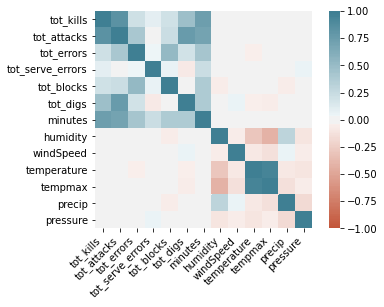

In [20]:
correlate = df_merged[["tot_kills","tot_attacks", "tot_errors",  "tot_serve_errors", "tot_blocks", "tot_digs", "minutes",
               'humidity','windSpeed', 'temperature', 'tempmax', 'precip','pressure']]

corr =  correlate.corr()
ax = sns.heatmap(
    corr, 
    vmin=-1, vmax=1, center=0,
    cmap=sns.diverging_palette(20, 220, n=200),
    square=True
)
ax.set_xticklabels(
    ax.get_xticklabels(),
    rotation=45,
    horizontalalignment='right'
);

Points per Game over Year: Now I describe the values of both game stats and weather stats over time. I used the mean values per game. By reviewing this plot I found out that it is important to add the year as a control because the dataset does not have the same quality each year. For instance, the year 2000 has lower points due to less available data.

In [21]:
df_year =df_merged.groupby('year')[['tot_aces','precip','humidity','tempmax','pressure','tot_kills', 'tot_errors','tot_serve_errors','tot_points']].mean()

In [22]:
# Understand shape of data in time
fig = px.bar(df_year, y='tot_points', opacity=0.5,width=800, height=350,
         title="Points per Game over Year",color_discrete_sequence=px.colors.qualitative.Bold)


fig.show()

In [23]:
from plotly.subplots import make_subplots
fig = make_subplots(rows=2, cols=2, start_cell="bottom-left")

Game Stats Plots: A finding of the plot on the top left is that Aces from 2002 to 2010 increase almost linearly; from 2.25 to 4.9 average per game. I'm not sure if there was any change in the game or technique during those years. But this again makes it more critical to include Year as a control variable.  

In [24]:
fig = make_subplots(rows=2, cols=2, subplot_titles=("Mean Aces over Years", "Mean Kills over Years", "Mean Serve Errors over Years","Mean Errors over Years"))
fig.add_trace(go.Bar(x=df_year.index, y=df_year.tot_aces,name='Aces',marker_color='mediumseagreen'),row=1, col=1 )
fig.add_trace(go.Bar(x=df_year.index, y=df_year.tot_kills ,name='Kills',marker_color= 'lightblue'),row=1, col=2)
fig.add_trace(go.Bar(x=df_year.index, y=df_year.tot_serve_errors,name='Serve Errors',marker_color= 'darkorange'),row=2, col=1)
fig.add_trace(go.Bar(x=df_year.index, y=df_year.tot_errors,name='Errors', marker_color= 'lightcoral'),row=2, col=2)
fig.show()



Weather Plots: As expected, yearly mean values of the weather stats do not have a trend. Something interesting to highlight is that
the temperature in the last three years has been one of the heighest. As shown in the plots average variability is low by year, but if we look at different locations (in the plots right after the next ones), such variability appears. (Not in pressure which values are pretty even, in general pressure does not change much, due to most games being held
at similar pressure at sea level)

In [25]:

fig = make_subplots(rows=2, cols=2, subplot_titles=("Humidity over Years", "Max Temperature over Years", "Precipitation over Years","Pressure over Years"))
fig.add_trace(go.Bar(x=df_year.index, y=df_year.humidity,name='humidity',marker_color=  'cornflowerblue'),row=1, col=1)
fig.add_trace(go.Bar(x=df_year.index, y=df_year.tempmax ,name='tempmax'),row=1, col=2)
fig.add_trace(go.Bar(x=df_year.index, y=df_year.precip,name='precip',marker_color= 'darkgrey'),row=2, col=1)
fig.add_trace(go.Bar(x=df_year.index, y=df_year.pressure,name='pressure',marker_color= 'blueviolet'),row=2, col=2)
fig.show()

Weather Plots by Location:If we look at different locations there is considerable variability in weather. Clearly locations is tighly related to weather. (Only pressure is pretty stable, also most games are done at similar pressure at the beach)

In [26]:
df_location =df_merged.groupby('tournament')[['tot_aces','precip','humidity','tempmax','pressure','tot_kills', 'tot_errors','tot_serve_errors','tot_points']].mean()

In [27]:
fig = make_subplots(rows=3, cols=2, subplot_titles=("Humidity over Years", "Max Temperature over Years", "","","Precipitation over Years","Pressure over Years"))
fig.add_trace(go.Bar(x=df_location.index, y=df_location.humidity,name='humidity',marker_color=  'cornflowerblue'),row=1, col=1)
fig.add_trace(go.Bar(x=df_location.index, y=df_location.tempmax ,name='tempmax'),row=1, col=2)
fig.add_trace(go.Bar(x=df_location.index, y=df_location.precip,name='precip',marker_color= 'darkgrey'),row=3, col=1)
fig.add_trace(go.Bar(x=df_location.index, y=df_location.pressure,name='pressure',marker_color= 'blueviolet'),row=3, col=2)
fig.show()

# d. Hypothesis Testing

In [28]:
# For statistics
from statsmodels.formula.api import ols


### Rejected null hypothesis -> Data favors alternative hypothesis

**1. Test if higher wind speed increase the probability of Aces per point played.** Set alpha value is 5%. In this case there is statistical significance. Higher winds increase aces. WindSpeed coeff 0.0002 which would mean on an average game of 77 points and wind speed 13.9 will have 0.2 more aces. While a high wind speed game will take place at 49.2 which would be 0.76 fewer aces. Hence difference is just 0.56 aces on very strong wind games vs regular ones. Which is almost negligible.  
It is important to highlight that wind directions is of great importance for this analysis of wind impact on aces; However, I don't have this data available.

In [29]:
model = ols("tot_aces_tot_points ~ windSpeed + year ", df_merged).fit()
print(model.summary())

                             OLS Regression Results                            
Dep. Variable:     tot_aces_tot_points   R-squared:                       0.097
Model:                             OLS   Adj. R-squared:                  0.096
Method:                  Least Squares   F-statistic:                     95.47
Date:                 Thu, 17 Dec 2020   Prob (F-statistic):               0.00
Time:                         11:28:06   Log-Likelihood:                 32363.
No. Observations:                16098   AIC:                        -6.469e+04
Df Residuals:                    16079   BIC:                        -6.454e+04
Df Model:                           18                                         
Covariance Type:             nonrobust                                         
                   coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------
Intercept        0.0463      0.001    

**2 - Test if Location affects the probability of Kills per point played**. Set alpha value 5%. In this case I didn't add year as a control because I lack enough data to make a correct yearly analysis by location.
The results are that some of the locations have an impact while others do not, which was expected. <br> 

Sand depth has a key impact when addressing location; I don't have such data. However,I can infere such impact using Hermosa Beach as an example. This beach has one of the deepest sand and, in my data analysis, it is a location that negatively affects the number of kills, which makes sense. In the ranking of high to low kills locations Hermosa is 167 out of 180 beaches for the least kills. The effect on a regular 77 points games would be 0.23 fewer kills in Hermosa than the default intercept.

In [30]:
model = ols("tot_kills_tot_points ~ tournament    ", df_merged).fit()
print(model.summary())

                             OLS Regression Results                             
Dep. Variable:     tot_kills_tot_points   R-squared:                       0.036
Model:                              OLS   Adj. R-squared:                  0.033
Method:                   Least Squares   F-statistic:                     10.71
Date:                  Thu, 17 Dec 2020   Prob (F-statistic):           2.59e-82
Time:                          11:28:07   Log-Likelihood:                 16436.
No. Observations:                 14649   AIC:                        -3.277e+04
Df Residuals:                     14597   BIC:                        -3.237e+04
Df Model:                            51                                         
Covariance Type:              nonrobust                                         
                                           coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------------

C:\Users\Francisco\anaconda3\lib\site-packages\statsmodels\base\model.py:1362: RuntimeWarning:

invalid value encountered in true_divide

C:\Users\Francisco\anaconda3\lib\site-packages\scipy\stats\_distn_infrastructure.py:1932: RuntimeWarning:

invalid value encountered in less_equal



In [31]:
#Generate the location ranking by number of kills coefficient
Location_kills = pd.DataFrame(model.params)
Location_kills = Location_kills[1:]
Location_kills.columns = ["coef"]
Location_kills["Rank"] = Location_kills["coef"].rank(ascending=False)
Location_kills= Location_kills.sort_values(by = ['coef'], ascending=False, axis=0)
# beaches with fewer kills given location
Location_kills[166:] 

,coef,Rank
tournament[T.Hermosa Beach],-0.003027,167.0
tournament[T.Rome],-0.004306,168.0
tournament[T.Miami],-0.006589,169.0
tournament[T.Belmar],-0.007450,170.0
tournament[T.Muskegon],-0.007604,171.0
tournament[T.Fort Lauderdale],-0.007730,172.0
tournament[T.Stare Jablonki],-0.009600,173.0
tournament[T.Seaside Heights],-0.010714,174.0
tournament[T.Beijing],-0.011478,175.0
tournament[T.New Orleans],-0.015569,176.0


**3 - Rain (precip) increases the probability of Serve errors per point played**.Set alpha value at 5%.  Rain coefficient has statistical significance. The increase is positive, as I stated in my hypothesis. 
Precip coefficient 0.0044, which would mean more serve errors with more precipitation. 
On an average game of 77 points and precip 0, The effect is obviously 0 errors dues to rain.
A rainy game with 2.9 inches (max rain recorded in a game) of showers would have 0.98 additional serve errors. Hence, a difference of almost 1 additional serve error on rainy games vs regular ones. However, most games are not played on rainy days. Therefore this information only confirms that beach volley is best played on a shiny day!

In [32]:
model = ols("tot_serve_errors_tot_points ~  precip + year ", df_merged).fit()
print(model.summary())

                                 OLS Regression Results                                
Dep. Variable:     tot_serve_errors_tot_points   R-squared:                       0.077
Model:                                     OLS   Adj. R-squared:                  0.076
Method:                          Least Squares   F-statistic:                     70.43
Date:                         Thu, 17 Dec 2020   Prob (F-statistic):          4.99e-234
Time:                                 11:28:07   Log-Likelihood:                 25656.
No. Observations:                        14413   AIC:                        -5.128e+04
Df Residuals:                            14395   BIC:                        -5.114e+04
Df Model:                                   17                                         
Covariance Type:                     nonrobust                                         
                   coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------

**4.1 Test if higher temperatures affect the probability of errors per point played.** Set alpha value at 5%. In this case, max temperature has statistical significance. Higher temperatures decrease errors. Coefficient of tempmax -0.0007 per point. On an average game of 77 points at 76.8 degrees; the impact of temperature would be 4.1 fewer errors per game. While for the maximum temperature games at 100 degrees 5.4 less. So at higher temperatures players in one game make 1.3 fewer errors in comparison to average temperatures. This sounds counterintuitive because of heat fatigue; however, this might make sense; according to the following article, Meteoroligst Allison Chinchar says *despite what many people may believe, which is that cooler weather is better and more comfortable to play in rather than the sizzling hot sand that could make your feet burn, its actually quite the opposite. She states that many players complain when it’s been too cold and that in reality, they are used to playing in the heat and hot conditions.*  https://beachmajorseries.com/en/388/faq-does-weather-affect-the-game%20delete

In [33]:
model = ols("tot_errors_tot_points ~  tempmax + year ", df_merged).fit()
print(model.summary())

                              OLS Regression Results                             
Dep. Variable:     tot_errors_tot_points   R-squared:                       0.080
Model:                               OLS   Adj. R-squared:                  0.078
Method:                    Least Squares   F-statistic:                     73.19
Date:                   Thu, 17 Dec 2020   Prob (F-statistic):          2.45e-243
Time:                           11:28:08   Log-Likelihood:                 20445.
No. Observations:                  14424   AIC:                        -4.085e+04
Df Residuals:                      14406   BIC:                        -4.072e+04
Df Model:                             17                                         
Covariance Type:               nonrobust                                         
                   coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------
Intercept        0

**4.2 Test if minutes played at higher temperature affect the probability of errors per point played.** <br>
This Test digs deeper into the max temperature - errors relationship. I analyze it from a fatigue perspective.
It is expected that on shorter games, fatigue is non existant and hot weather is enjoyable. As it was described on 
the previous Test (4.1), but as games are longer, the fatigue impact increases directly related to minutes played. 
I tested this new model by running the next regression *tot_errors_tot_points ~  year  + tempmax+ minutes * tempmax*, including max temperature and its interaction with minutes played; the results is that both coefficients have statistical significance.
The tempmax coefficient is -0.0008 and the interaction 2.144*10-6. However, the value of the interaction is too small.
Exemplify with game values:
In an average game of 77 points, 45 minutes, and 76.8 degrees. Games would have 4.1 fewer errors. A long game of 120 minutes
with 77 points and a high temperature of 100 Celcius would have 4 fewer errors. Hence, almost the same as in the shorter
game. The difference is negligible because the interaction terms is not big enough to increase the errors by a larger amount than the max temperature negative coefficient.

In [34]:
# testing 
model = ols("tot_errors_tot_points ~  year  + tempmax+ minutes:tempmax", df_merged).fit()
print(model.summary())

                              OLS Regression Results                             
Dep. Variable:     tot_errors_tot_points   R-squared:                       0.081
Model:                               OLS   Adj. R-squared:                  0.080
Method:                    Least Squares   F-statistic:                     70.26
Date:                   Thu, 17 Dec 2020   Prob (F-statistic):          2.18e-246
Time:                           11:28:08   Log-Likelihood:                 20346.
No. Observations:                  14350   AIC:                        -4.065e+04
Df Residuals:                      14331   BIC:                        -4.051e+04
Df Model:                             18                                         
Covariance Type:               nonrobust                                         
                      coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------------
Intercept   

---------------------------------------------------------------------------------
---------------------------------------------------------------------------------

### Fail to reject null hypothesis -> Alternative hypothesis were wrong

**5. Test if humidity increases the probability of kills per point played.**. Alpha value is 5%. In this case humidity appears with no stastistical significance. Plus, the direction of the effect is opposite to my hipothesis, higher humidity would decrease errors.

In [35]:
model = ols("tot_kills_tot_points ~  humidity + year ", df_merged).fit()
print(model.summary())

                             OLS Regression Results                             
Dep. Variable:     tot_kills_tot_points   R-squared:                       0.015
Model:                              OLS   Adj. R-squared:                  0.014
Method:                   Least Squares   F-statistic:                     12.43
Date:                  Thu, 17 Dec 2020   Prob (F-statistic):           3.62e-37
Time:                          11:28:10   Log-Likelihood:                 16047.
No. Observations:                 14466   AIC:                        -3.206e+04
Df Residuals:                     14447   BIC:                        -3.191e+04
Df Model:                            18                                         
Covariance Type:              nonrobust                                         
                   coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------
Intercept        0.6216     

**6. Test if lower atmospheric pressure increases the probability of errors per point played.** Alpha value is 5%. 
In this case our hypothesis does not have statistical significance to reject the null hypothesis for pressure coefficient. At least the direction of our  hypothesis is right; lower pressure increases chance of error.

In [36]:
model = ols("tot_errors_tot_points ~ pressure + year ", df_merged).fit()
print(model.summary())

                              OLS Regression Results                             
Dep. Variable:     tot_errors_tot_points   R-squared:                       0.012
Model:                               OLS   Adj. R-squared:                  0.011
Method:                    Least Squares   F-statistic:                     10.43
Date:                   Thu, 17 Dec 2020   Prob (F-statistic):           1.91e-25
Time:                           11:28:10   Log-Likelihood:                 18305.
No. Observations:                  13092   AIC:                        -3.658e+04
Df Residuals:                      13076   BIC:                        -3.646e+04
Df Model:                             15                                         
Covariance Type:               nonrobust                                         
                   coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------
Intercept        0

# Summary Table of Hypothesis Testing and Potential next steps

In [37]:

import plotly.graph_objects as go

headerColor = 'darkblue'


fig = go.Figure(data=[go.Table(
  header=dict(
    values=['<b>Hypothesis</b>','<b>Rejected Null Hypothesis</b>','<b>Coefficient</b>','<b>Potential Impact per Game</b>','<b>Promising Future Research</b>'],
    line_color='darkslategray',
    fill_color=headerColor,
    align=['left','center'],
    font=dict(color='white', size=12)
  ),
  cells=dict(
    values=[
      ['1. High Wind Speed -> More aces', '2. Location -> More/Fewer kills', '3. Rain -> Increase serve errors', 
       '4.1. Max Temperature -> Affect game errors', '4.2. (Max Temperature * Minutes) -> Affect game errors',
      '5. Higher Humidity -> Increase kills','6. Lower Pressure -> Increase game errors'],
      ['Yes', 'Yes', 'Yes', 'Yes','Yes','No', 'No'],
      ['0.0002 * WindSpeed' , 'e.g. -0.003027 * Hermosa Beach', '0.0044 * Precip','-0.0007 * tempmax' ,
       '-0.0008 * tempmax + 2.144e-06 * (tempmax * minutes)','Unknown','Unknown'],
      ['0.56 Additional aces per game', '0.23 fewer kills at Hermosa Beach', '1 additional server error', 
       '1.3 fewer errors', "Effect is practically 0",'Unknown','Unknown'],
      [ 'Find wind direction data to analyze', 'Find detailed location info such as sand depth to analyze', 
       'Not necessary - rainy games are uncommon', 
       'Analyze other models and relationship such as player age and fatigue', 'As stated in 4.1', 
       'Not necessary - appears there is no relationship',
       'Analyze if certain players have advantage/disadvantage playing at lower pressure']],
    line_color='darkslategray',
    # 2-D list of colors for alternating rows
    
    align = ['left', 'center'],
    font = dict(color = 'darkslategray', size = 11)
    ))
])
fig.update_layout(width=950, height=700)
fig.show()